In [1]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skimage as ski
import cv2

from scipy import ndimage as ndi

from skimage import data, util, filters, color
from skimage.segmentation import watershed
from skimage.feature import peak_local_max


from scipy.optimize import curve_fit
from sklearn.linear_model import BayesianRidge

def read_data(id):
    # Leer el archivo de datos correspondiente al id de la galaxia
    file_path = f'../DATA/processed/TracingPoints/data_rho_{id}_filtered.csv'
    data = pd.read_csv(file_path)
    return data

def sort_by_delta_rho(data):
    # Ordenar las partículas por deltaRho en orden decreciente
    sorted_data = data.sort_values(by='deltaRho', ascending=False).reset_index(drop=True)
    return sorted_data

# Colores
h_alpha_color = '#DC143C'  # emisiones H-alpha - Carmesí o rojo


/home/daniel/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:35: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps,
/home/daniel/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/least_angle.py:597: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  eps=np.finfo(np.float).eps, copy_X=Tr

In [3]:
#funciones

def cartesian_to_polar(x, y):
    """
    Convert Cartesian coordinates (x, y) to polar coordinates (r, phi).
    
    Parameters:
    x : array-like
        x-coordinates.
    y : array-like
        y-coordinates.
    
    Returns:
    r : array-like
        Radial distance from the origin.
    phi : array-like
        Angle in radians.
    """
    # Calculate radial distance
    r = np.sqrt(x**2 + y**2)
    
    # Calculate the angle using atan2 (handles all quadrants)
    phi = np.arctan2(y, x)
    
    return r, phi


def polar_to_cartesian(r, phi):
    """
    Convert polar coordinates (r, phi) to Cartesian coordinates (x, y).
    
    Parameters:
    r : array-like
        Radial distance from the origin.
    phi : array-like
        Angle in radians.
    
    Returns:
    x : array-like
        x-coordinates.
    y : array-like
        y-coordinates.
    """
    x = r * np.cos(phi)
    y = r * np.sin(phi)
    
    return x, y


# Clase para el ajuste Bayesiano
class BayesianSpiralFitter:
    def __init__(self, alpha_1=1e-6, lambda_1=1e-6):
        self.bayesian_ridge = BayesianRidge(alpha_1=alpha_1, lambda_1=lambda_1)
        self.A_ = None
        self.B_ = None
        self.N_ = None
        self.r2_score_ = None

    def fit(self, phi, r):
        # Preprocesar los valores: φ, tan(φ/2), tan(φ/2N)
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        self.bayesian_ridge.fit(X, r)
        
        # Obtener los coeficientes ajustados
        self.A_ = self.bayesian_ridge.coef_[0]
        self.B_ = self.bayesian_ridge.coef_[1]
        self.N_ = self.bayesian_ridge.coef_[2]
        
        # Calcular el score R^2 para este ajuste
        self.r2_score_ = self.bayesian_ridge.score(X, r)
        return self.r2_score_

    def predict(self, phi, r_min, r_max):
        """
        Predecir los valores de r para un rango de φ dentro de r_min y r_max.
        Filtra los valores de r fuera del rango dado.
        """
        X = np.column_stack([phi, np.tan(phi / 2), np.tan(phi / 2)])
        r_pred = self.bayesian_ridge.predict(X)
        
        # Aplicar el filtro de r_min y r_max
        mask = (r_pred >= r_min) & (r_pred <= r_max)
        return r_pred[mask], phi[mask]  # Devuelve los valores de r y phi filtrados



# Dividir los puntos en subconjuntos de 3 en 3
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]


In [4]:
id_halo = 11
data = read_data(id_halo)

sorted_data = sort_by_delta_rho(data)

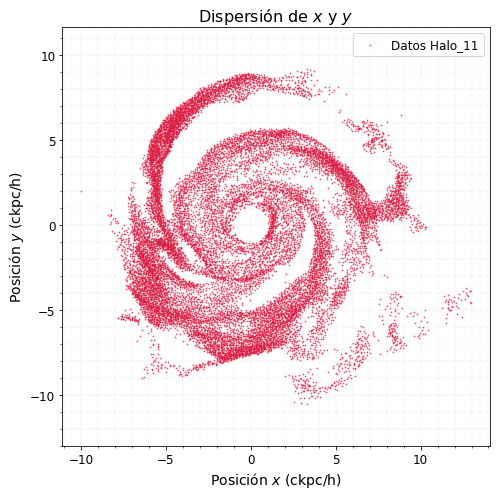

In [5]:
x = sorted_data['x']
y = sorted_data['y']

# Figura x,y halo
fig, ax = plt.subplots(figsize=(7, 7))

scatter = ax.scatter(x, y, c=h_alpha_color, s=0.7, alpha=0.6, label=f'Datos Halo_{id_halo}')

ax.set_title(r'Dispersión de $x$ y $y$', fontsize=16)
ax.set_xlabel(r'Posición $x$ (ckpc/h)', fontsize=14)
ax.set_ylabel(r'Posición $y$ (ckpc/h)', fontsize=14)
ax.legend(loc='best', fontsize=12)

ax.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
ax.minorticks_on()
ax.tick_params(axis='both', which='major', labelsize=12)
ax.tick_params(axis='both', which='minor', labelsize=10)
ax.axis('equal')

plt.tight_layout()
plt.show()


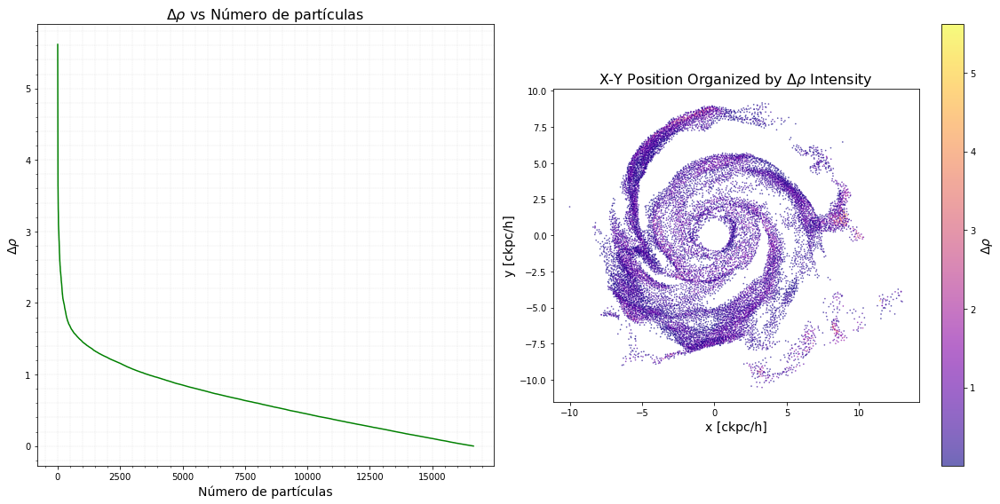

In [6]:
# Datos
x = sorted_data['x']
y = sorted_data['y']
delta_rho = sorted_data['deltaRho']
num_particles = range(1, len(delta_rho) + 1)

# Gráficas
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))

# Primer gráfico: DeltaRho vs Número de partículas
ax1.plot(num_particles, delta_rho, color='g', linewidth=1.5)
ax1.set_title(r'$\Delta \rho$ vs Número de partículas', fontsize=16)
ax1.set_xlabel(r'Número de partículas', fontsize=14)
ax1.set_ylabel(r'$\Delta \rho$', fontsize=14)
ax1.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
ax1.minorticks_on()

# Segundo gráfico: Posición X-Y de las partículas, organizadas por la intensidad de DeltaRho
scatter = ax2.scatter(x, y, c=delta_rho, cmap='plasma', s=0.5, alpha=0.6)
ax2.set_title(r'X-Y Position Organized by $\Delta \rho$ Intensity', fontsize=16)
ax2.set_xlabel('x [ckpc/h]', fontsize=14)
ax2.set_ylabel('y [ckpc/h]', fontsize=14)
ax2.set_aspect('equal', adjustable='box')

# Barra de color
cbar = fig.colorbar(scatter, ax=ax2, orientation='vertical')
cbar.set_label(r'$\Delta \rho$', fontsize=14)


plt.tight_layout()
plt.show()


## Cartesian to Polar Transformations
To transform Cartesian coordinates \((x, y)\) into polar coordinates \((r, $\phi$)\), we use the following mathematical relationships:

$$
r = \sqrt{x^2 + y^2}
$$

$$
\phi = \text{atan2}(y, x)
$$

Here, \( r \) is the radial distance from the origin, and \( $\phi$ \) is the angle (in radians) measured counterclockwise from the positive \(x\)-axis.


## Inverse Polar to Cartesian:
These transformations:

$$
x = r \cdot \cos(\phi)
$$
$$
y = r \cdot \sin(\phi)
$$


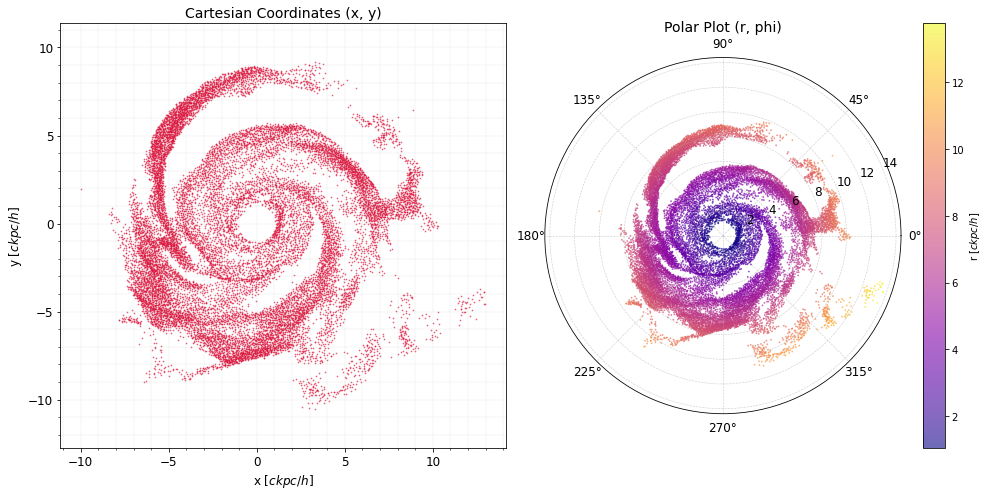

In [7]:
x_values_s = sorted_data['x'].values
y_values_s = sorted_data['y'].values

# Convert to polar coordinates
r_values_sorted, phi_values_sorted = cartesian_to_polar(x_values_s, y_values_s)

# Plotting the Cartesian and Polar Coordinates
fig = plt.figure(figsize=(14, 7))

# Plot Cartesian coordinates
ax1 = fig.add_subplot(121)
ax1.scatter(x_values_s, y_values_s, c=h_alpha_color, s=0.5, alpha=0.6)
ax1.set_title('Cartesian Coordinates (x, y)', fontsize=14)
ax1.set_xlabel('x [$\it{ckpc/h}$]', fontsize=12)
ax1.set_ylabel('y [$\it{ckpc/h}$]', fontsize=12)
ax1.set_aspect('equal')
ax1.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
ax1.minorticks_on()
ax1.tick_params(axis='both', which='major', labelsize=12)
ax1.tick_params(axis='both', which='minor', labelsize=10)
ax1.axis('equal')

# Plot Polar coordinates 
ax2 = fig.add_subplot(122, projection='polar')
sc = ax2.scatter(phi_values_sorted, r_values_sorted, c=r_values_sorted, cmap='plasma', s=0.7, alpha=0.6)
ax2.set_title('Polar Plot (r, phi)', fontsize=14)
ax2.grid(True, which='both', linestyle='--', linewidth=0.6, alpha=0.6)
ax2.tick_params(axis='both', which='major', labelsize=12)

plt.colorbar(sc, ax=ax2, label='r [$\it{ckpc/h}$]')

plt.tight_layout()
plt.show()



## A new formula describing the scaffold structure of spiral galaxies

The formula presented in the article is:

$$
r(\phi) = \frac{A}{\log \left( B \tan \left( \frac{\phi}{2N} \right) \right)}
$$

Where:
- \( A \) is a scale parameter,
- \( B \) controls the bulge-to-arm size,
- \( N \) determines the spiral's tightness, and
- \( $\phi $\) is the polar angle.


- **`spiral_structure`** function takes the angle \( $\phi$ \), and parameters \( A \), \( B \), and \( N \) to compute the radial distance \( r($\phi$) \) for the spiral.

  
### Customization:
- You can adjust the parameters \( A \), \( B \), and \( N \) based on the specific galaxy morphology or dataset.
- The formula allows flexibility in fitting different types of spiral structures, and you can fine-tune these parameters to fit your galaxy data.



In [8]:
def spiral_structure(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    
    Parameters:
    phi : array-like
        Array of angle values in radians.
    A : float
        Scale parameter for the spiral.
    B : float
        Parameter that controls the bulge-to-arm size.
    N : float
        Winding number that controls the spiral's tightness.
    
    Returns:
    r : array-like
        Radial distances corresponding to the angle values.
    """
    r = A / np.log(B * np.tan(phi / (2 * N)))
    return r



## Numerical Estimation


## Ajuste con curve_fit

/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in log
  import sys


Parámetros ajustados: A = -0.5030690658648425, B = 1.133603558405297, N = 0.9888308798205969


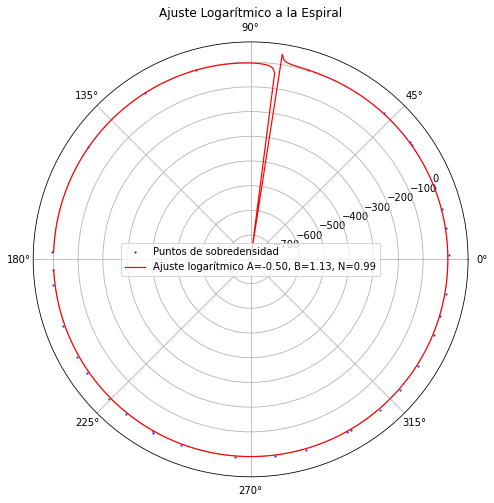

In [9]:
# Definir la función de espiral logarítmica a ajustar
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Cargar los datos 
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares (r, φ)
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Ajuste por mínimos cuadrados no lineales usando curve_fit de scipy
def fit_log_spiral_numerical(r_values, phi_values):

    initial_guess = [1.0, 1.0, 1.0]
    
    # Ajustar los datos con curve_fit
    try:
        popt, pcov = curve_fit(log_spiral, phi_values, r_values, p0=initial_guess, maxfev=10000)
    except RuntimeError:
        print("No se pudo ajustar el modelo a los datos")
        return None, None

    # Retornar los parámetros ajustados (A, B, N)
    return popt, pcov

# Ajustar el modelo y obtener los parámetros A, B y N
params, covariance = fit_log_spiral_numerical(r_values, phi_values)

if params is not None:
    A_fit, B_fit, N_fit = params
    print(f"Parámetros ajustados: A = {A_fit}, B = {B_fit}, N = {N_fit}")

    # Graficar 
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 500)
    r_fit = log_spiral(phi_fit, A_fit, B_fit, N_fit)

    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))
    ax.scatter(phi_values, r_values, color='blue', s=2, alpha=0.6, label='Puntos de sobredensidad')
    ax.plot(phi_fit, r_fit, label=f'Ajuste logarítmico A={A_fit:.2f}, B={B_fit:.2f}, N={N_fit:.2f}', color='red', linewidth=1.2)
    ax.set_title('Ajuste Logarítmico a la Espiral')
    ax.legend()
    plt.show()
else:
    print("No se pudo realizar el ajuste")


### 2do intento

-
Usando BayesianRidge
-

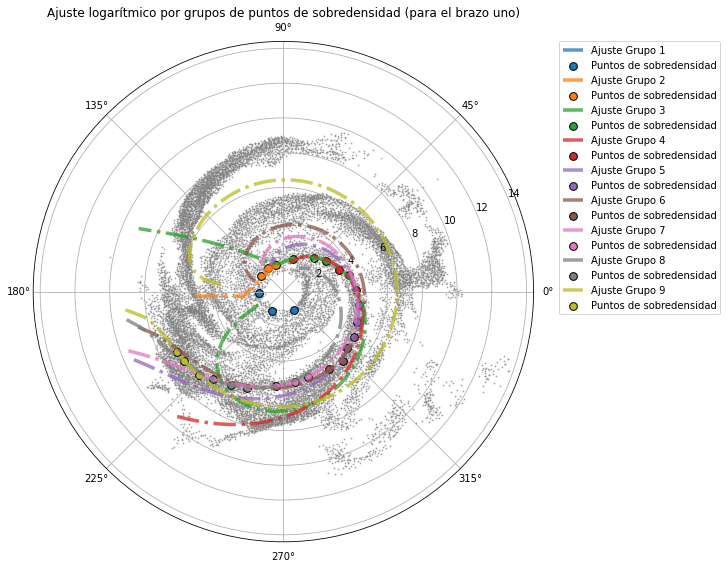

In [10]:
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

# Función logarítmica de la espiral incluyendo A, B y N
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Definir los límites de radio para los ajustes
r_min = np.percentile(r_values_sorted, 2.5)  # 5% más cercano al centro
r_max = np.percentile(r_values_sorted, 97.5)  # 95% más lejano al borde

# Lista ajustes y estadísticas
adjustment_info = []

fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))

# Puntos originales
ax.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')

# Ajustar para cada conjunto de tres puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values, phi_values)):
    if len(r_group) < 3:  # Asegurarnos de que haya 3 puntos en el grupo
        continue

    # Omitir el primer y el último grupo
    if group_index == 0 or (group_index + 1) * 3 >= len(r_values):
        continue

    # Ajuste bayesiano para este subconjunto
    bayesian_spiral = BayesianSpiralFitter()
    r2_score = bayesian_spiral.fit(phi_group, r_group)
    
    # Guardar los valores del ajuste en la lista
    adjustment_info.append({
        'grupo': group_index,
        'A': bayesian_spiral.A_,
        'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_,
        'r_min': r_min,
        'r_max': r_max,
        'phi_group': phi_group,
        'r_group': r_group,
        'r2_score': r2_score  # Guardar el score R^2
    })
    
    # Ajuste para todo el rango global de φ dentro del rango [r_min, r_max]
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 100)  # Usar el phi global
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    ax.plot(phi_fit_filtered, r_fit, '-.' ,label=f'Ajuste Grupo {group_index}',linewidth=3.5, alpha=0.75)
    ax.scatter(phi_group, r_group, label='Puntos de sobredensidad', edgecolor= 'black', s=60)


ax.set_title('Ajuste logarítmico por grupos de puntos de sobredensidad (para el brazo uno)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico
plt.show();


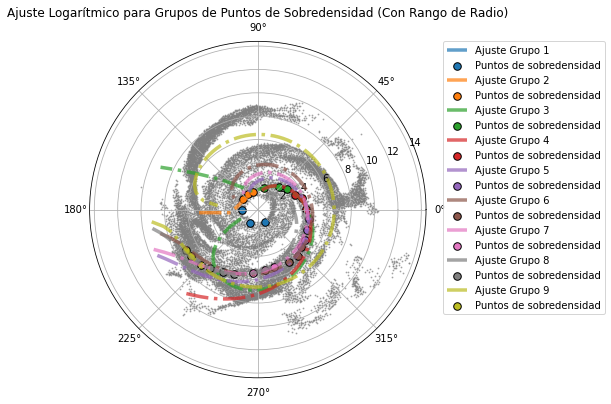

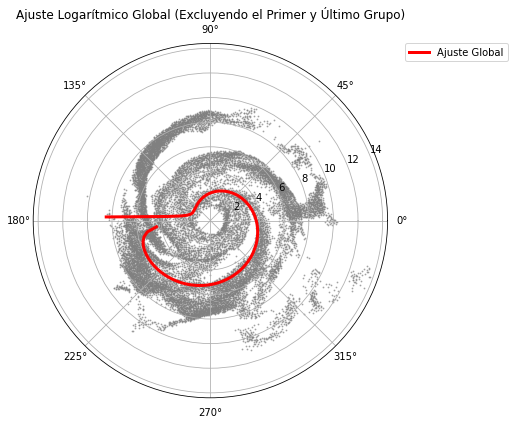

In [11]:
# Definir la función logarítmica de la espiral incluyendo A, B y N
def log_spiral(phi, A, B, N):
    """
    r(φ) = A / log(B * tan(φ / 2N))
    """
    safe_phi = np.clip(phi, 1e-6, None)  # Evitar valores problemáticos para tan y log
    return A / np.log(B * np.tan(safe_phi / (2 * N)) + 1e-6)


# Cargar los datos
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Límites de radio 
r_min = np.percentile(r_values_sorted, 2.5)  # 5% más cercano al centro
r_max = np.percentile(r_values_sorted, 97.5)  # 95% más lejano al borde

# Lista ajustes y estadísticas
adjustment_info = []

# Ajustar y graficar para cada grupo de 3 puntos
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))

# Graficar los puntos originales
ax.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')

# Almacenar los puntos para el ajuste global 
#(excluyendo el primer y último grupo)
r_values_for_global = []
phi_values_for_global = []

# Ajustar para cada conjunto de tres puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values, phi_values)):
    if len(r_group) < 3:  # Asegurarnos de que haya 3 puntos en el grupo
        continue

    # Omitir el primer y el último grupo
    if group_index == 0 or (group_index + 1) * 3 >= len(r_values):
        continue

    # Guardar los valores de r y phi para el ajuste global
    r_values_for_global.extend(r_group)
    phi_values_for_global.extend(phi_group)

    # Ajuste bayesiano para este subconjunto
    bayesian_spiral = BayesianSpiralFitter()
    r2_score = bayesian_spiral.fit(phi_group, r_group)
    
    # Guardar los valores del ajuste en la lista
    adjustment_info.append({
        'grupo': group_index,
        'A': bayesian_spiral.A_,
        'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_,
        'r_min': r_min,
        'r_max': r_max,
        'phi_group': phi_group,
        'r_group': r_group,
        'r2_score': r2_score  # Guardar el score R^2
    })
    
    # Ajuste para todo el rango global de φ dentro del rango [r_min, r_max]
    phi_fit = np.linspace(np.min(phi_values), np.max(phi_values), 100)  # Usar el phi global
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    # Graficar el ajuste para este subconjunto
    ax.plot(phi_fit_filtered, r_fit, '-.', label=f'Ajuste Grupo {group_index}', linewidth=3.5, alpha=0.7)
    ax.scatter(phi_group, r_group, label='Puntos de sobredensidad', edgecolor='black', s=57)

# Ajustar leyenda y moverla fuera de la gráfica
ax.set_title('Ajuste Logarítmico para Grupos de Puntos de Sobredensidad (Con Rango de Radio)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico
plt.show()

# Ajuste Global (para todos los puntos, menos el primer y último grupo)
# Convertir a numpy arrays para el ajuste global
r_values_for_global = np.array(r_values_for_global)
phi_values_for_global = np.array(phi_values_for_global)

# Realizar el ajuste global con todos los puntos
bayesian_spiral_global = BayesianSpiralFitter()
r2_score_global = bayesian_spiral_global.fit(phi_values_for_global, r_values_for_global)

# Predecir los valores ajustados para todo el rango global de φ dentro del rango [r_min, r_max]
phi_fit_global = np.linspace(np.min(phi_values), np.max(phi_values), 100)
r_fit_global, phi_fit_filtered_global = bayesian_spiral_global.predict(phi_fit_global, r_min, r_max)

# Graficar el ajuste global
fig, ax_global = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(7, 6))
ax_global.plot(phi_fit_filtered_global, r_fit_global, label='Ajuste Global', color='red', linewidth=3)
ax_global.scatter(phi_values_sorted, r_values_sorted, s=0.7, alpha=0.6, c='gray')
ax_global.set_title('Ajuste Logarítmico Global (Excluyendo el Primer y Último Grupo)')
plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
plt.tight_layout()

# Mostrar el gráfico global
plt.show()



In [12]:
print(f"Ajuste Global: A = {bayesian_spiral_global.A_}, B = {bayesian_spiral_global.B_}, N = {bayesian_spiral_global.N_}, R^2 = {r2_score_global:.4f}")


Ajuste Global: A = -1.030445663182945, B = 0.06974937008071613, N = 0.06974937008072146, R^2 = 0.6008


In [13]:
for adjustment in adjustment_info:
    print(f"Grupo: {adjustment['grupo']}, A: {adjustment['A']}, B: {adjustment['B']}, N: {adjustment['N']}, R^2: {adjustment['r2_score']:.4f}")


Grupo: 1, A: -0.04554300048861058, B: -0.0005767136535506307, N: -0.0005767136535506307, R^2: 1.0000
Grupo: 2, A: 0.34666173679792944, B: -0.06500197074830302, N: -0.06500197074830302, R^2: 1.0000
Grupo: 3, A: -3.5886680354432663, B: 1.5203860675557603, N: 1.5203860675557603, R^2: 1.0000
Grupo: 4, A: -1.1554431650692538, B: -0.6005033359601774, N: -0.6005033359601774, R^2: 0.8919
Grupo: 5, A: -0.6487091025269099, B: -0.3771645714060246, N: -0.3771645714060246, R^2: 0.9657
Grupo: 6, A: -0.3123227121574796, B: -0.18252241628735869, N: -0.18252241628735869, R^2: 0.4898
Grupo: 7, A: -0.16747348111814858, B: -0.4504023383582848, N: -0.4504023383582848, R^2: 0.9880
Grupo: 8, A: -1.3426505386566614, B: -0.09558675800310645, N: -0.09558675800310645, R^2: 1.0000
Grupo: 9, A: 0.032917424507592274, B: -0.0777750598349223, N: -0.0777750598349223, R^2: 1.0000


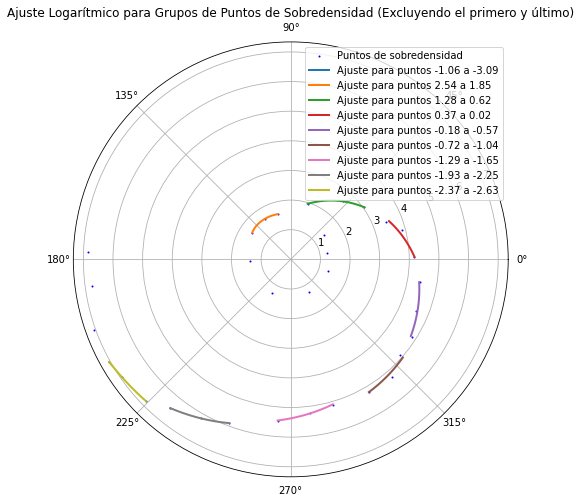

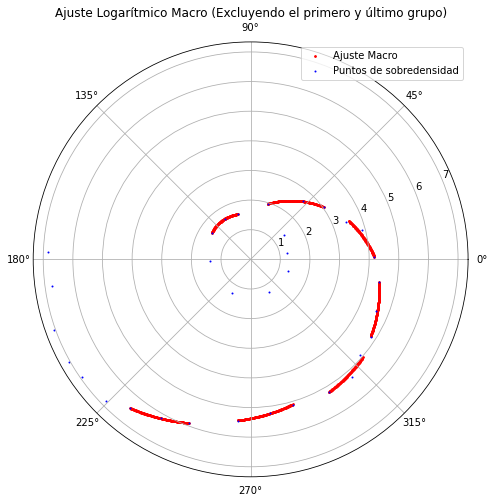

In [14]:
# Cargar los datos
data_arm = pd.read_csv('../DATA/processed/TracingPoints/arm_tracing_11_arm1_rho_dani.csv')

# Extraer los valores de x e y
x_values = data_arm['x'].values
y_values = data_arm['y'].values

# Convertir a coordenadas polares
r_values, phi_values = cartesian_to_polar(x_values, y_values)

# Función para dividir los puntos en subconjuntos de 3 en 3
def divide_points_in_groups(r_values, phi_values, group_size=3):
    for i in range(0, len(r_values), group_size):
        yield r_values[i:i+group_size], phi_values[i:i+group_size]

# Ajustar y graficar para cada grupo de 3 puntos
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))

# Graficar los puntos originales
ax.scatter(phi_values, r_values, color='blue', label='Puntos de sobredensidad', s=1)

# Almacenar los ajustes intermedios (sin el primer y último grupo)
intermediate_fits = []

# Ajustar para cada conjunto de tres puntos, excluyendo el primero y el último
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values, phi_values)):
    if len(r_group) < 3:  # Asegurarnos de que haya 3 puntos en el grupo
        continue

    # Omitir el primer y el último grupo
    if group_index == 0 or (group_index + 1) * 3 >= len(r_values):
        continue

    # Ajuste bayesiano para este subconjunto
    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)
    
    # Predecir los valores ajustados para este grupo
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit= bayesian_spiral.predict(phi_fit, r_min, r_max)
    
    # Almacenar los ajustes intermedios
    intermediate_fits.append((phi_fit, r_fit))
    
    # Graficar el ajuste para este subconjunto
    ax.plot(phi_fit, r_fit, label=f'Ajuste para puntos {phi_group[0]:.2f} a {phi_group[-1]:.2f}', linewidth=2)

ax.set_title('Ajuste Logarítmico para Grupos de Puntos de Sobredensidad (Excluyendo el primero y último)')
plt.legend()
plt.show()

# AJUSTE MACRO
# Ahora concatenamos solo los valores ajustados de los grupos intermedios (no el primero ni el último)

# Concatenar solo los phi y r ajustados de los grupos intermedios
all_phi_fit = np.concatenate([phi_fit for group_index, (phi_fit, r_fit) in enumerate(intermediate_fits)
                              if group_index != 0 and group_index != len(intermediate_fits)-1])
all_r_fit = np.concatenate([r_fit for group_index, (phi_fit, r_fit) in enumerate(intermediate_fits)
                            if group_index != 0 and group_index != len(intermediate_fits)-1])

# Graficar el ajuste macro con los puntos de sobredensidad
fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))
ax.scatter(all_phi_fit, all_r_fit, label='Ajuste Macro', color='red', s=3)
ax.scatter(phi_values, r_values, color='blue', label='Puntos de sobredensidad', s=1)
ax.set_title('Ajuste Logarítmico Macro (Excluyendo el primero y último grupo)')
plt.legend()
plt.show()


In [17]:
import csv


## watershed

In [19]:
# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Parámetros de umbral y ajuste
likelihood_threshold = 0.30  # Ajustar para hacer menos estricta la condición
chi_squared_threshold = 3.5  # Aumentar para permitir más flexibilidad en el ajuste

# Diccionario para almacenar los ajustes por brazo
arm_adjustments = {}
arm_count = 0

# Diccionario para almacenar la información de los ajustes y estadísticas
adjustment_info = []

# Función para calcular chi_squared
def chi_squared(y_obs, y_pred):
    return np.sum((y_obs - y_pred)**2 / np.clip(y_pred, 1e-6, None))  # Evitar división por cero

# Función para calcular el likelihood (simplificada)
def likelihood_comparison(previous_group, current_group):
    return np.exp(-np.abs(np.mean(previous_group) - np.mean(current_group)))

# Función para asegurar la dirección coherente de los brazos
def ensure_trailing_direction(phi_group, reference_direction):
    """ Ajustar los ángulos para asegurar que todos los brazos sigan la misma dirección (trailing)."""
    if np.mean(phi_group) < reference_direction:  # Si el ángulo promedio es menor, ajustar
        return phi_group + 2 * np.pi  # Ajuste a la misma dirección
    return phi_group

# Seleccionar la dirección de referencia para el primer grupo
reference_direction = np.mean(phi_values_s[:3])  # Se elige usando las primeras partículas

# Repetir el ciclo de ajuste y almacenar información para cada conjunto de puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    # Asegurar que todos los brazos sigan la misma dirección (trailing)
    phi_group = ensure_trailing_direction(phi_group, reference_direction)

    # Si es el primer grupo, realizar el ajuste inicial
    if group_index == 0:
        bayesian_spiral = BayesianSpiralFitter()
        r2_score = bayesian_spiral.fit(phi_group, r_group)
        
        # Calcular el ajuste para todos los puntos del grupo
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        # Almacenar el grupo y el ajuste en el primer brazo
        arm_adjustments[arm_count] = {'groups': []}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': r2_score,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })
        continue

    # Comparar el grupo actual con el grupo anterior
    previous_group = arm_adjustments[arm_count]['groups'][-1]['r_group']

    # Calcular el chi-squared y el likelihood entre el grupo actual y el anterior
    chi_sq_value = chi_squared(r_group, previous_group)
    likelihood_value = likelihood_comparison(previous_group, r_group)

    # Si el grupo pertenece al mismo brazo, se añade al mismo brazo
    if chi_sq_value < chi_squared_threshold and likelihood_value > likelihood_threshold:
        bayesian_spiral.fit(phi_group, r_group)
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })
    else:
        # Si no cumple con las condiciones, crear un nuevo brazo
        arm_count += 1
        bayesian_spiral.fit(phi_group, r_group)
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        arm_adjustments[arm_count] = {'groups': []}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info para el nuevo brazo
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })

# Guardar la información de los ajustes en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    for data in adjustment_info:
        writer.writerow(data)


total_arms = len(arm_adjustments)
total_particles = sum([len(arm_adjustments[arm]['groups']) * 3 for arm in arm_adjustments])  # Cada grupo contiene 3 partículas
print(f"\nSe crearon {total_arms} brazos.")
print(f"Se utilizaron un total de {total_particles} partículas para el ajuste.")



Se crearon 3634 brazos.
Se utilizaron un total de 16644 partículas para el ajuste.


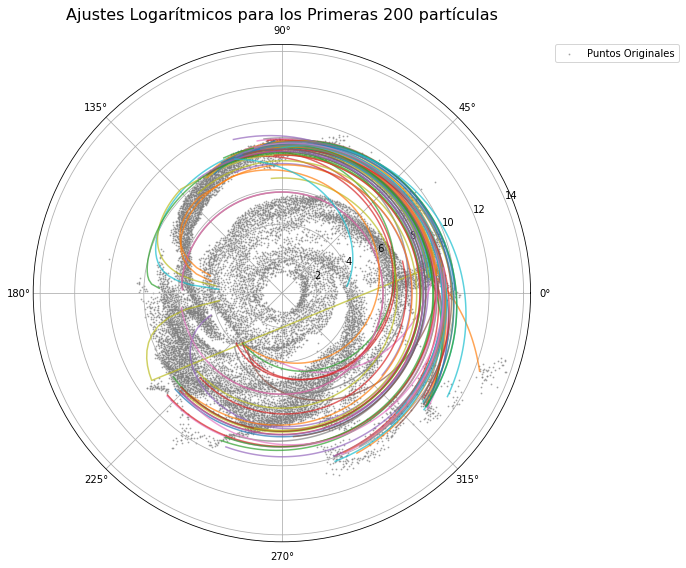

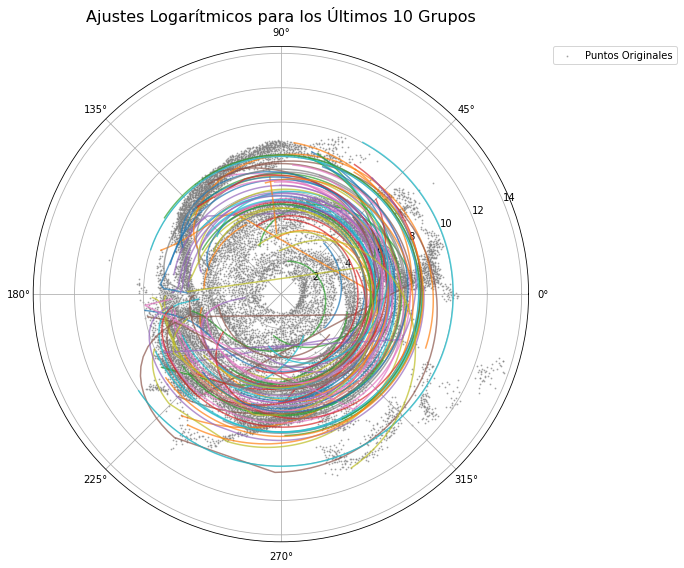

In [21]:
def plot_adjustments(adjustments, title):
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))

    ax.scatter(phi_values_s, r_values_s, s=0.7, alpha=0.6, c='gray', label='Puntos Originales')

    for adj in adjustments:
        phi_fit = np.array(adj['phi_fit'])
        r_fit = np.array(adj['r_fit'])
        ax.plot(phi_fit, r_fit, linewidth=1.5, alpha=0.7)

    ax.set_title(title, fontsize=16)
    plt.legend(loc='upper left', bbox_to_anchor=(1.05, 1), borderaxespad=0.)
    plt.tight_layout()
    plt.show()

first_10_adjustments = adjustment_info[:100]
last_10_adjustments = adjustment_info[-100:]

# Graficar los primerosajustes
plot_adjustments(first_10_adjustments, 'Ajustes Logarítmicos para los Primeras 200 partículas')

# Graficar los últimos ajustes
plot_adjustments(last_10_adjustments, 'Ajustes Logarítmicos para los Últimos 10 Grupos')

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import csv

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Parámetros de umbral para chi-squared
chi_squared_threshold = 35  # Definir el umbral para determinar si los puntos pertenecen al mismo brazo

# Diccionario para almacenar los ajustes por brazo
arm_adjustments = {}
arm_count = 0

# Diccionario para almacenar la información de los ajustes y estadísticas
adjustment_info = []

# Función para calcular chi_squared
def chi_squared(y_obs, y_pred):
    return np.sum((y_obs - y_pred)**2 / np.clip(y_pred, 1e-6, None))  # Evitar división por cero

# Repetir el ciclo de ajuste y almacenar información para cada conjunto de puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue

    # Si es el primer grupo, realizar el ajuste inicial
    if group_index == 0:
        bayesian_spiral = BayesianSpiralFitter()
        r2_score = bayesian_spiral.fit(phi_group, r_group)
        
        # Calcular el ajuste para todos los puntos del grupo
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        # Almacenar el grupo y el ajuste en el primer brazo
        arm_adjustments[arm_count] = {'groups': []}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': r2_score,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })
        continue

    # Comparar el grupo actual con el grupo anterior
    previous_group = arm_adjustments[arm_count]['groups'][-1]['r_group']

    # Calcular el chi-squared entre el grupo actual y el anterior
    chi_sq_value = chi_squared(r_group, previous_group)

    # Si el grupo pertenece al mismo brazo, se añade al mismo brazo
    if chi_sq_value < chi_squared_threshold:
        bayesian_spiral.fit(phi_group, r_group)
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })
    else:
        # Si no cumple con las condiciones, crear un nuevo brazo
        arm_count += 1
        bayesian_spiral.fit(phi_group, r_group)
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        arm_adjustments[arm_count] = {'groups': []}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })

        # Almacenar en adjustment_info para el nuevo brazo
        adjustment_info.append({
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })

# Guardar la información de los ajustes en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    for data in adjustment_info:
        writer.writerow(data)

# Imprimir resumen final
total_arms = len(arm_adjustments)
total_particles = sum([len(arm_adjustments[arm]['groups']) * 3 for arm in arm_adjustments])  # Cada grupo contiene 3 partículas
print(f"\nSe crearon {total_arms} brazos.")
print(f"Se utilizaron un total de {total_particles} partículas para el ajuste.")



Se crearon 97 brazos.
Se utilizaron un total de 16644 partículas para el ajuste.


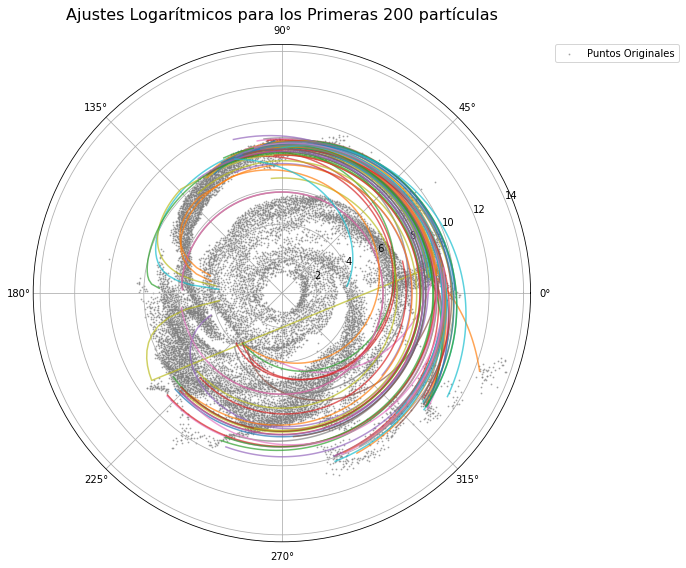

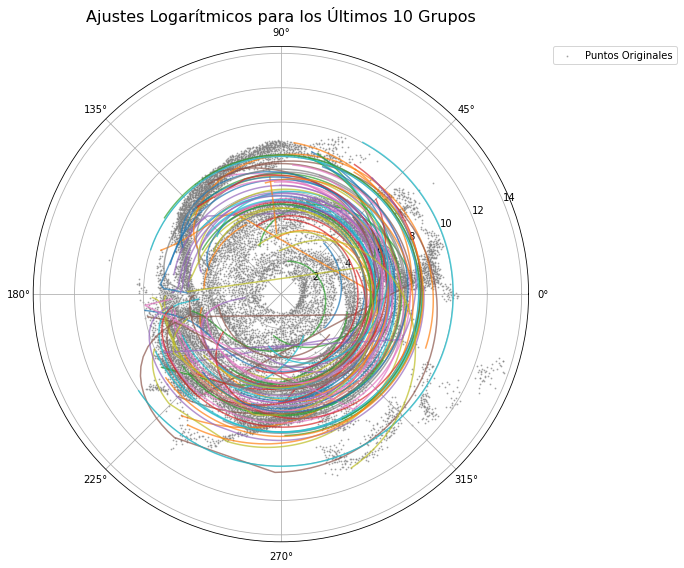

In [25]:
first_10_adjustments = adjustment_info[:100]
last_10_adjustments = adjustment_info[-100:]

# Graficar los primerosajustes
plot_adjustments(first_10_adjustments, 'Ajustes Logarítmicos para los Primeras 200 partículas')

# Graficar los últimos ajustes
plot_adjustments(last_10_adjustments, 'Ajustes Logarítmicos para los Últimos 10 Grupos')

In [28]:
adjustment_info[-1:]


[{'grupo': 5547,
  'A': -0.00034859546802504894,
  'B': -0.0006954622910467689,
  'N': -0.0006954622910467689,
  'r_min': 4.465628640562656,
  'r_max': 12.93180775001042,
  'phi_group': [-2.70840641168286, -0.36165922665575695, 2.812618248849144],
  'r_group': [6.63290998752145, 12.93180775001042, 4.465628640562656],
  'phi_fit': [-2.70840641168286,
   -2.6526384858189003,
   -2.5968705599549406,
   -2.541102634090981,
   -2.4853347082270214,
   -2.429566782363062,
   -2.373798856499102,
   -2.3180309306351425,
   -2.262263004771183,
   -2.2064950789072233,
   -2.1507271530432637,
   -2.094959227179304,
   -2.039191301315344,
   -1.9834233754513846,
   -1.927655449587425,
   -1.8718875237234653,
   -1.8161195978595057,
   -1.760351671995546,
   -1.7045837461315865,
   -1.6488158202676269,
   -1.5930478944036672,
   -1.5372799685397076,
   -1.481512042675748,
   -1.4257441168117884,
   -1.3699761909478285,
   -1.314208265083869,
   -1.2584403392199093,
   -1.2026724133559497,
   -1.1469

In [38]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import csv

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

# Parámetro de umbral basado en la distancia entre grupos de partículas
distance_threshold = 4.5  # Ajustar este valor según las distancias observadas

# Diccionario para almacenar los ajustes por brazo
arm_adjustments = {}
arm_count = 0

# Lista para almacenar la información de los ajustes y estadísticas
adjustment_info = []

# Función para calcular la distancia entre los grupos de puntos
def calculate_distance(r_group1, r_group2):
    """Calcula la distancia promedio entre dos grupos de puntos."""
    return np.mean(np.abs(r_group1 - r_group2))

# Repetir el ciclo de ajuste y almacenar información para cada conjunto de puntos
for group_index, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3:
        continue  # Ignorar grupos pequeños

    # Si es el primer grupo, realizar el ajuste inicial
    if group_index == 0:
        bayesian_spiral = BayesianSpiralFitter()
        r2_score = bayesian_spiral.fit(phi_group, r_group)
        
        # Calcular el ajuste para el grupo inicial
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        # Almacenar el primer brazo
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': r2_score,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })
        arm_adjustments[arm_count]['total_particles'] += len(r_group)

        # Almacenar en adjustment_info
        adjustment_info.append({
            'brazo': arm_count,
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'num_particles': len(r_group),  # Número de partículas en este grupo
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': r2_score
        })
        continue

    # Comparar el grupo actual con el grupo anterior para verificar si están lo suficientemente cerca
    previous_group = arm_adjustments[arm_count]['groups'][-1]['r_group']
    distance = calculate_distance(r_group, previous_group)

    # Si la distancia es menor al umbral, recalcular el ajuste
    if distance < distance_threshold:
        # Recalcular el ajuste para todos los puntos del grupo actual y el anterior
        combined_r_group = np.concatenate([previous_group, r_group])
        combined_phi_group = np.concatenate([arm_adjustments[arm_count]['groups'][-1]['phi_group'], phi_group])

        bayesian_spiral.fit(combined_phi_group, combined_r_group)
        phi_fit = np.linspace(np.min(combined_phi_group), np.max(combined_phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(combined_r_group), np.max(combined_r_group))

        # Almacenar los resultados en el mismo brazo
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })
        arm_adjustments[arm_count]['total_particles'] += len(r_group)

        # Actualizar la información de ajustes
        adjustment_info.append({
            'brazo': arm_count,
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'num_particles': len(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': bayesian_spiral.r2_score_
        })
    else:
        # Si la distancia es mayor, iniciar un nuevo brazo
        arm_count += 1
        bayesian_spiral.fit(phi_group, r_group)
        phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
        r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

        # Crear un nuevo brazo
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}
        arm_adjustments[arm_count]['groups'].append({
            'r_group': r_group, 
            'phi_group': phi_group, 
            'A': bayesian_spiral.A_, 
            'B': bayesian_spiral.B_, 
            'N': bayesian_spiral.N_, 
            'r2_score': bayesian_spiral.r2_score_,
            'phi_fit': phi_fit_filtered,
            'r_fit': r_fit
        })
        arm_adjustments[arm_count]['total_particles'] += len(r_group)

        # Almacenar en adjustment_info para el nuevo brazo
        adjustment_info.append({
            'brazo': arm_count,
            'grupo': group_index,
            'A': bayesian_spiral.A_,
            'B': bayesian_spiral.B_,
            'N': bayesian_spiral.N_,
            'r_min': np.min(r_group),
            'r_max': np.max(r_group),
            'num_particles': len(r_group),
            'phi_group': list(phi_group),
            'r_group': list(r_group),
            'phi_fit': list(phi_fit_filtered),
            'r_fit': list(r_fit),
            'r2_score': bayesian_spiral.r2_score_
        })

# Guardar la información de los ajustes en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    for data in adjustment_info:
        writer.writerow(data)

# Resumen final con detalles de cada brazo
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")

for arm, arm_data in arm_adjustments.items():
    num_groups = len(arm_data['groups'])
    total_particles_in_arm = arm_data['total_particles']
    print(f"Brazo {arm}:")
    print(f"  - Número de grupos: {num_groups}")
    print(f"  - Total de partículas: {total_particles_in_arm}")

total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas para el ajuste.")



Se crearon 135 brazos.
Brazo 0:
  - Número de grupos: 63
  - Total de partículas: 189
Brazo 1:
  - Número de grupos: 43
  - Total de partículas: 129
Brazo 2:
  - Número de grupos: 30
  - Total de partículas: 90
Brazo 3:
  - Número de grupos: 1
  - Total de partículas: 3
Brazo 4:
  - Número de grupos: 8
  - Total de partículas: 24
Brazo 5:
  - Número de grupos: 5
  - Total de partículas: 15
Brazo 6:
  - Número de grupos: 49
  - Total de partículas: 147
Brazo 7:
  - Número de grupos: 130
  - Total de partículas: 390
Brazo 8:
  - Número de grupos: 32
  - Total de partículas: 96
Brazo 9:
  - Número de grupos: 31
  - Total de partículas: 93
Brazo 10:
  - Número de grupos: 128
  - Total de partículas: 384
Brazo 11:
  - Número de grupos: 1
  - Total de partículas: 3
Brazo 12:
  - Número de grupos: 5
  - Total de partículas: 15
Brazo 13:
  - Número de grupos: 5
  - Total de partículas: 15
Brazo 14:
  - Número de grupos: 159
  - Total de partículas: 477
Brazo 15:
  - Número de grupos: 1
  - To

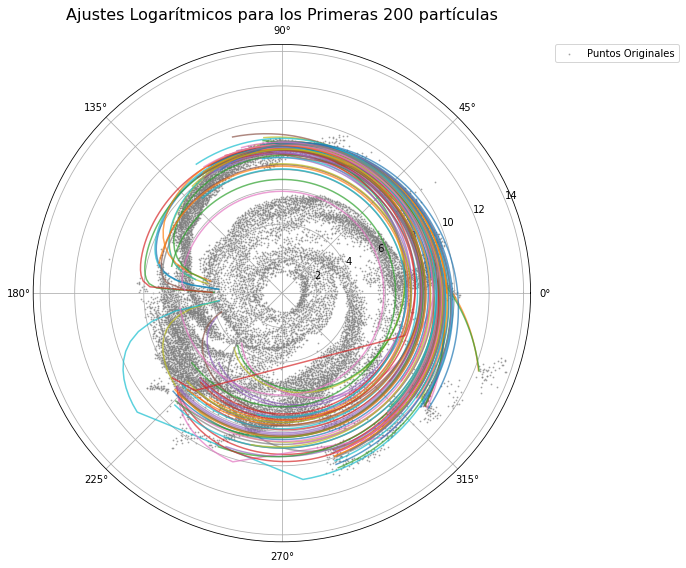

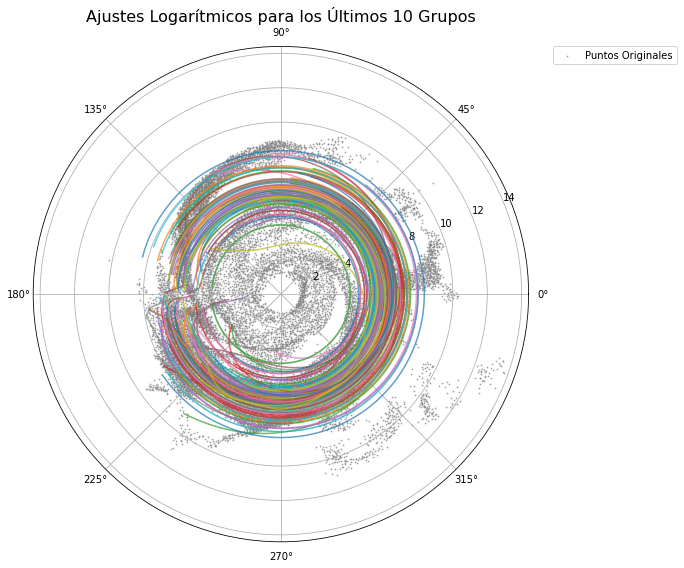

In [39]:
first_10_adjustments = adjustment_info[:100]
last_10_adjustments = adjustment_info[-100:]

# Graficar los primerosajustes
plot_adjustments(first_10_adjustments, 'Ajustes Logarítmicos para los Primeras 200 partículas')

# Graficar los últimos ajustes
plot_adjustments(last_10_adjustments, 'Ajustes Logarítmicos para los Últimos 10 Grupos')

In [40]:
adjustment_info[-1:]

[{'brazo': 134,
  'grupo': 5547,
  'A': -0.0035055273476411524,
  'B': -0.0038859934849771066,
  'N': -0.0038859934849771066,
  'r_min': 4.465628640562656,
  'r_max': 12.93180775001042,
  'num_particles': 3,
  'phi_group': [-2.70840641168286, -0.36165922665575695, 2.812618248849144],
  'r_group': [6.63290998752145, 12.93180775001042, 4.465628640562656],
  'phi_fit': [-2.70840641168286,
   -2.6526384858189003,
   -2.5968705599549406,
   -2.541102634090981,
   -2.4853347082270214,
   -2.429566782363062,
   -2.373798856499102,
   -2.3180309306351425,
   -2.262263004771183,
   -2.2064950789072233,
   -2.1507271530432637,
   -2.094959227179304,
   -2.039191301315344,
   -1.9834233754513846,
   -1.927655449587425,
   -1.8718875237234653,
   -1.8161195978595057,
   -1.760351671995546,
   -1.7045837461315865,
   -1.6488158202676269,
   -1.5930478944036672,
   -1.5372799685397076,
   -1.481512042675748,
   -1.4257441168117884,
   -1.3699761909478285,
   -1.314208265083869,
   -1.258440339219909

In [ ]:
arm_adjustments

In [41]:
import matplotlib.pyplot as plt
import numpy as np

# Función para graficar los ajustes de cada brazo
def plot_arms_and_fits(arm_adjustments):
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))

    # Colores para diferenciar los brazos
    colors = plt.cm.viridis(np.linspace(0, 1, len(arm_adjustments)))

    # Graficar los ajustes para cada brazo
    for arm, arm_data in arm_adjustments.items():
        arm_color = colors[arm]  # Color específico para este brazo
        for group in arm_data['groups']:
            # Graficar los puntos originales de cada grupo
            ax.scatter(group['phi_group'], group['r_group'], label=f'Brazo {arm}', color=arm_color, s=10, alpha=0.7)

            # Graficar los ajustes de cada grupo
            ax.plot(group['phi_fit'], group['r_fit'], color=arm_color, linewidth=1.5, alpha=0.8)

    # Configuración del gráfico
    ax.set_title('Ajustes de Brazos Espirales', fontsize=16)
    ax.set_xlabel(r'$\phi$ [rad]', fontsize=14)
    ax.set_ylabel(r'$r$ [ckpc/h]', fontsize=14)
    ax.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)

    plt.legend(loc='upper right', bbox_to_anchor=(1.2, 1.0), title='Brazos')
    plt.tight_layout()
    plt.show()

# Llamada a la función para graficar
plot_arms_and_fits(arm_adjustments)


/home/daniel/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:28: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.


ValueError: Image size of 557x83294 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 720x576 with 1 Axes>

In [20]:
# Datos organizados de sorted_data
x = sorted_data['x'].values
y = sorted_data['y'].values
delta_rho = sorted_data['deltaRho'].values

# Convertir a coordenadas polares para el ajuste
r_values_s, phi_values_s = cartesian_to_polar(x, y)

distance_threshold = 4.2  # Umbral basado en la distancia entre grupos
arm_adjustments, adjustment_info = {}, []
arm_count = 0

# Calcular distancia entre grupos
def calculate_distance(r1, r2): return np.mean(np.abs(r1 - r2))

# Ciclo para ajustar los brazos
for group_idx, (r_group, phi_group) in enumerate(divide_points_in_groups(r_values_s, phi_values_s)):
    if len(r_group) < 3: continue
    if group_idx == 0 or calculate_distance(r_group, arm_adjustments[arm_count]['groups'][-1]['r_group']) >= distance_threshold:
        arm_count += 1
        arm_adjustments[arm_count] = {'groups': [], 'total_particles': 0}

    bayesian_spiral = BayesianSpiralFitter()
    bayesian_spiral.fit(phi_group, r_group)
    
    phi_fit = np.linspace(np.min(phi_group), np.max(phi_group), 100)
    r_fit, phi_fit_filtered = bayesian_spiral.predict(phi_fit, np.min(r_group), np.max(r_group))

    arm_adjustments[arm_count]['groups'].append({
        'r_group': r_group, 'phi_group': phi_group, 'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_,
        'N': bayesian_spiral.N_, 'r2_score': bayesian_spiral.r2_score_, 'phi_fit': phi_fit_filtered, 'r_fit': r_fit
    })
    arm_adjustments[arm_count]['total_particles'] += len(r_group)
    
    adjustment_info.append({
        'brazo': arm_count, 'grupo': group_idx, 
        'A': bayesian_spiral.A_, 'B': bayesian_spiral.B_, 'N': bayesian_spiral.N_,
        'r_min': np.min(r_group), 'r_max': np.max(r_group), 'num_particles': len(r_group),
        'phi_group': list(phi_group), 'r_group': list(r_group), 
        'phi_fit': list(phi_fit_filtered), 'r_fit': list(r_fit),
        'r2_score': bayesian_spiral.r2_score_
    })

# Guardar la información en un archivo CSV
with open('adjustment_info.csv', mode='w', newline='') as file:
    writer = csv.DictWriter(file, fieldnames=adjustment_info[0].keys())
    writer.writeheader()
    writer.writerows(adjustment_info)

# Resumen de brazos
total_arms = len(arm_adjustments)
print(f"\nSe crearon {total_arms} brazos.")
for arm, arm_data in arm_adjustments.items():
    print(f"Brazo {arm}: Número de grupos: {len(arm_data['groups'])}, Total partículas: {arm_data['total_particles']}")
total_particles = sum([arm_data['total_particles'] for arm_data in arm_adjustments.values()])
print(f"Se utilizaron un total de {total_particles} partículas.")




Se crearon 222 brazos.
Brazo 1: Número de grupos: 45, Total partículas: 135
Brazo 2: Número de grupos: 18, Total partículas: 54
Brazo 3: Número de grupos: 28, Total partículas: 84
Brazo 4: Número de grupos: 15, Total partículas: 45
Brazo 5: Número de grupos: 30, Total partículas: 90
Brazo 6: Número de grupos: 1, Total partículas: 3
Brazo 7: Número de grupos: 8, Total partículas: 24
Brazo 8: Número de grupos: 5, Total partículas: 15
Brazo 9: Número de grupos: 49, Total partículas: 147
Brazo 10: Número de grupos: 130, Total partículas: 390
Brazo 11: Número de grupos: 21, Total partículas: 63
Brazo 12: Número de grupos: 11, Total partículas: 33
Brazo 13: Número de grupos: 31, Total partículas: 93
Brazo 14: Número de grupos: 59, Total partículas: 177
Brazo 15: Número de grupos: 30, Total partículas: 90
Brazo 16: Número de grupos: 1, Total partículas: 3
Brazo 17: Número de grupos: 12, Total partículas: 36
Brazo 18: Número de grupos: 26, Total partículas: 78
Brazo 19: Número de grupos: 1, T

In [22]:
arm_adjustments

{1: {'groups': [{'r_group': array([9.18401795, 9.00341859, 9.03650608]),
    'phi_group': array([0.15672857, 0.13731382, 0.18578795]),
    'A': 4.5078664765387015e-05,
    'B': 2.2483777182098565e-05,
    'N': 2.2483777182098565e-05,
    'r2_score': 2.0042677054687985e-06,
    'phi_fit': array([0.13731382, 0.13780346, 0.13829309, 0.13878273, 0.13927237,
           0.13976201, 0.14025164, 0.14074128, 0.14123092, 0.14172056,
           0.1422102 , 0.14269983, 0.14318947, 0.14367911, 0.14416875,
           0.14465838, 0.14514802, 0.14563766, 0.1461273 , 0.14661693,
           0.14710657, 0.14759621, 0.14808585, 0.14857548, 0.14906512,
           0.14955476, 0.1500444 , 0.15053404, 0.15102367, 0.15151331,
           0.15200295, 0.15249259, 0.15298222, 0.15347186, 0.1539615 ,
           0.15445114, 0.15494077, 0.15543041, 0.15592005, 0.15640969,
           0.15689933, 0.15738896, 0.1578786 , 0.15836824, 0.15885788,
           0.15934751, 0.15983715, 0.16032679, 0.16081643, 0.16130606,
     

IndexError: index 221 is out of bounds for axis 0 with size 221

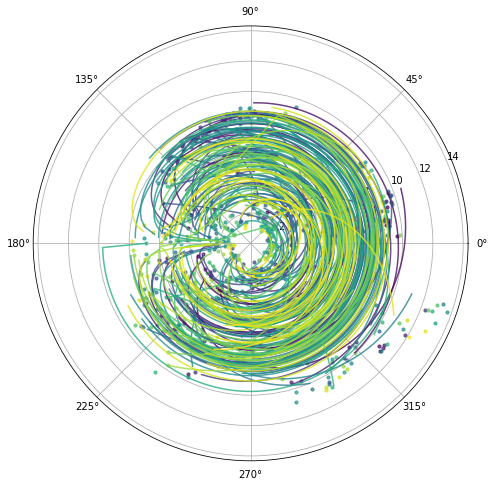

In [23]:

# Función para graficar los ajustes de cada brazo
def plot_arms_and_fits(arm_adjustments, max_groups_per_arm=1):
    fig, ax = plt.subplots(subplot_kw={'projection': 'polar'}, figsize=(10, 8))
    
    # Colores para diferenciar los brazos
    colors = plt.cm.viridis(np.linspace(0, 1, len(arm_adjustments)))
    
    # Graficar los ajustes para cada brazo
    for arm, arm_data in arm_adjustments.items():
        arm_color = colors[arm]  # Color específico para este brazo
        num_groups = len(arm_data['groups'])

        # Limitar el número de grupos por brazo para evitar gráficas demasiado grandes
        for group in arm_data['groups'][:max_groups_per_arm]:  # Limitar a max_groups_per_arm
            # Graficar los puntos originales de cada grupo
            ax.scatter(group['phi_group'], group['r_group'], color=arm_color, s=10, alpha=0.7)
            # Graficar los ajustes de cada grupo
            ax.plot(group['phi_fit'], group['r_fit'], color=arm_color, linewidth=1.5, alpha=0.8)

    # Configuración del gráfico
    ax.set_title('Ajustes de Brazos Espirales', fontsize=16)
    ax.grid(True, which='both', linestyle='--', linewidth=0.4, alpha=0.4)
    plt.tight_layout()
    plt.show()

# Llamada a la función para graficar (limitando a los primeros 10 grupos por brazo)
plot_arms_and_fits(arm_adjustments, max_groups_per_arm=1)
